In [1]:
!pip uninstall torch torchvision -y
!pip install torch==1.4.0 torchvision==0.5.0

Uninstalling torch-1.5.0+cu101:
  Successfully uninstalled torch-1.5.0+cu101
Uninstalling torchvision-0.6.0+cu101:
  Successfully uninstalled torchvision-0.6.0+cu101
     |████████████████████████████████| 753.4MB 21kB/s 
     |████████████████████████████████| 4.0MB 42.3MB/s 


In [0]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, classification_report

In [3]:
path = Path("/content/drive/My Drive/Image Classification/Intel Image Classification")
path.ls()

[PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/intel-image-classification.zip'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/stage-1.pth'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/stage-1-unfreeze.pth'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/stage-2.pth'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/tmp.pth'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/stage-2-unfreeze.pth'),
 PosixPath('/content/drive/My Drive/Image Classification/Intel Image Classification/Intel image Classifier.pkl')]

In [0]:
train_path = Path("/content/seg_train/seg_train")
test_path = Path("/content/seg_test/seg_test")

In [5]:
if not train_path.exists() : 
    img_file = (path.ls()[0]).as_posix()
    !unzip "{img_file}" 

Streaming output truncated to the last 5000 lines.
  inflating: seg_train/seg_train/mountain/7537.jpg  
  inflating: seg_train/seg_train/mountain/7539.jpg  
  inflating: seg_train/seg_train/mountain/7551.jpg  
  inflating: seg_train/seg_train/mountain/7560.jpg  
  inflating: seg_train/seg_train/mountain/7565.jpg  
  inflating: seg_train/seg_train/mountain/7578.jpg  
  inflating: seg_train/seg_train/mountain/7581.jpg  
  inflating: seg_train/seg_train/mountain/7586.jpg  
  inflating: seg_train/seg_train/mountain/7647.jpg  
  inflating: seg_train/seg_train/mountain/7652.jpg  
  inflating: seg_train/seg_train/mountain/7654.jpg  
  inflating: seg_train/seg_train/mountain/7662.jpg  
  inflating: seg_train/seg_train/mountain/767.jpg  
  inflating: seg_train/seg_train/mountain/7672.jpg  
  inflating: seg_train/seg_train/mountain/7679.jpg  
  inflating: seg_train/seg_train/mountain/7681.jpg  
  inflating: seg_train/seg_train/mountain/7693.jpg  
  inflating: seg_train/seg_train/mountain/7695.jp

In [0]:
def getDataFromFolder(path, bs, size = 224, seed = 1997, split = True) : 

    """
    """
    src = ImageList.from_folder(path)
    if split : 
        src = src.split_by_rand_pct(0.2, seed)
    else : 
        src = src.split_none()
    src = src.label_from_folder()
    
    data = (src.transform(get_transforms(), size = size) \
            .databunch(bs = bs) \
            .normalize(imagenet_stats))
    
    return data, src

In [0]:
train_data, train_src = getDataFromFolder(train_path, bs = 64, size = 128, seed = 1997)
test_data, test_src = getDataFromFolder(train_path, bs = 64, size = 128, seed = 1997, split = False)

In [0]:
train_data

ImageDataBunch;

Train: LabelList (11228 items)
x: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: CategoryList
buildings,buildings,buildings,buildings,buildings
Path: /content/seg_train/seg_train;

Valid: LabelList (2806 items)
x: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: CategoryList
forest,mountain,sea,forest,forest
Path: /content/seg_train/seg_train;

Test: None

In [0]:
test_data

ImageDataBunch;

Train: LabelList (14034 items)
x: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: CategoryList
buildings,buildings,buildings,buildings,buildings
Path: /content/seg_train/seg_train;

Valid: LabelList (0 items)
x: ImageList

y: CategoryList

Path: /content/seg_train/seg_train;

Test: None

In [0]:
target_classes = train_data.classes

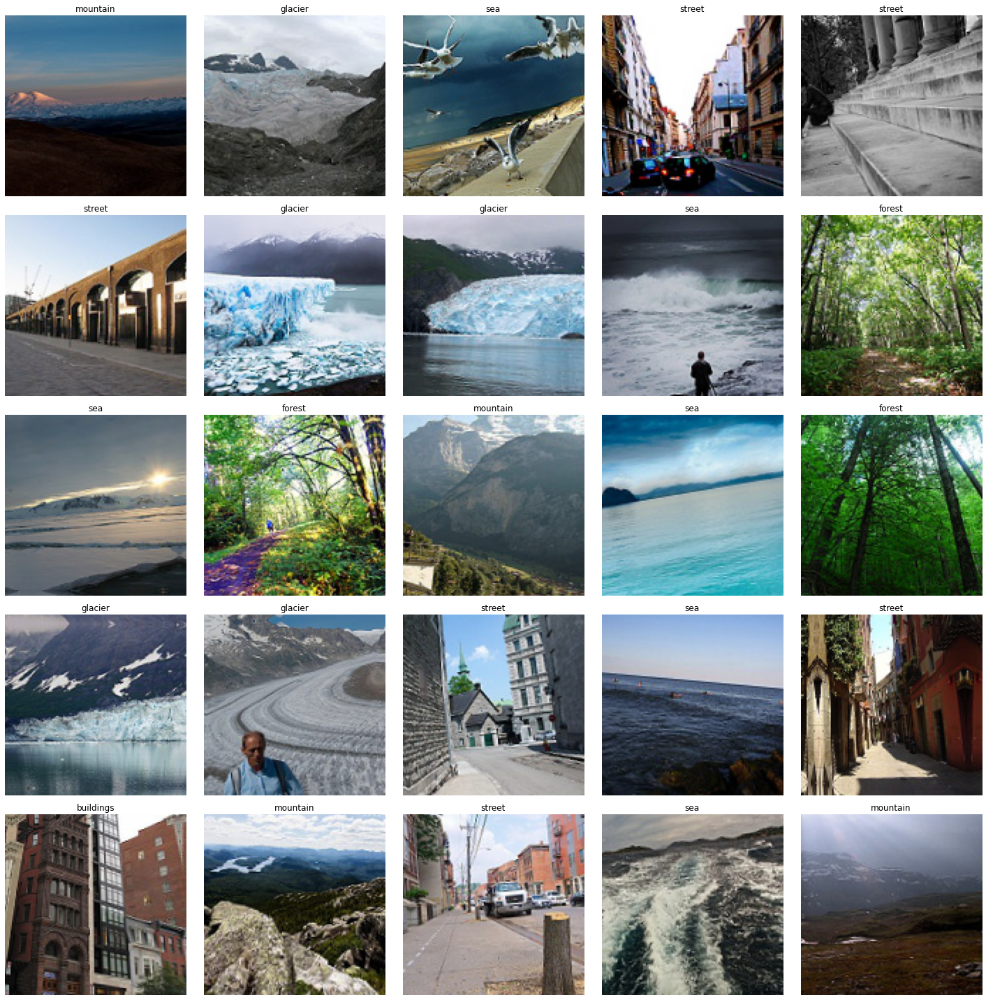

In [0]:
train_data.show_batch(ds_type = DatasetType.Train)

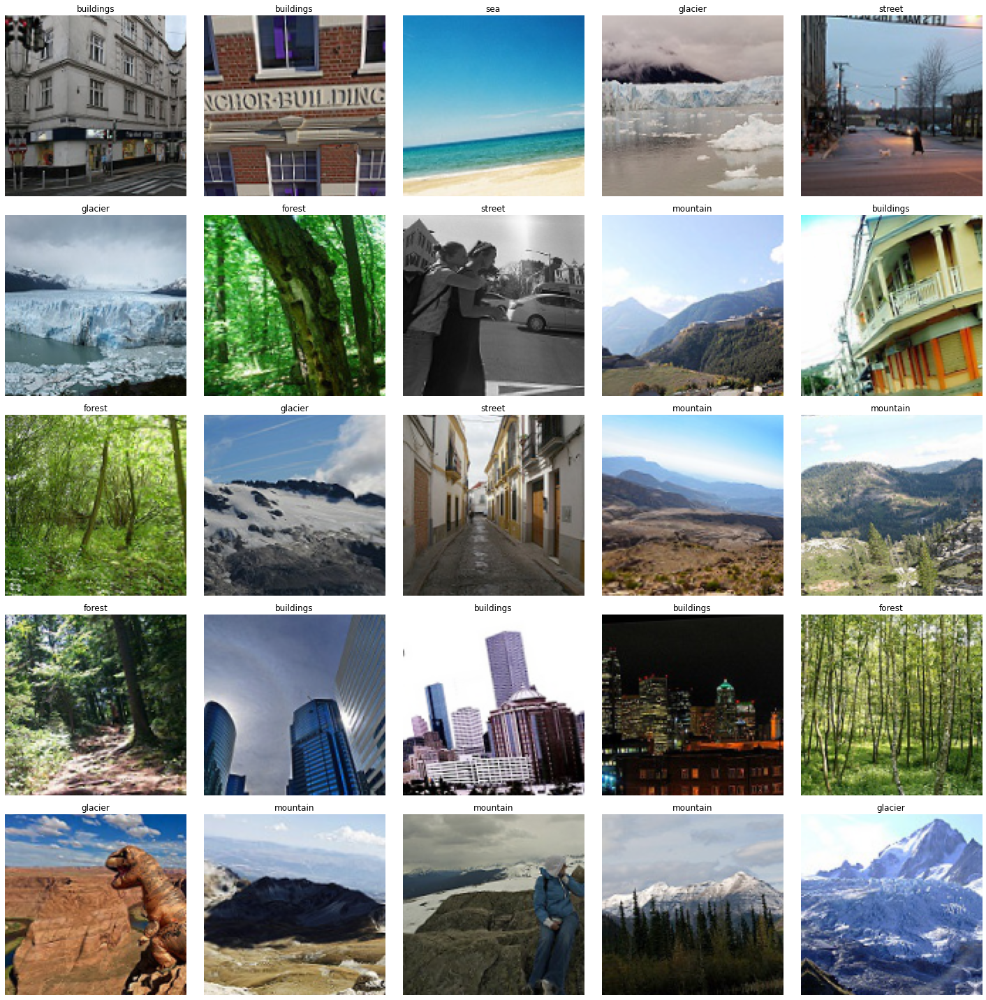

In [0]:
test_data.show_batch(ds_type = DatasetType.Train)

In [0]:
arch = models.resnet50
learn = cnn_learner(train_data, base_arch = arch, metrics = accuracy, wd = 1e-2)
learn.model_dir = path
learn.summary()

Sequential
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 64, 64]         9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
______________________________________________________________________
MaxPool2d            [64, 32, 32]         0          False     
______________________________________________________________________
Conv2d               [64, 32, 32]         4,096      False     
______________________________________________________________________
BatchNorm2d          [64, 32, 32]         128        True      
______________________________________________________________________
Conv2d               [64, 32, 32]         36,864     False     
___________________________________________________

In [0]:
cbs = [ShowGraph]

In [0]:
def plot_lr() : 
    learn.lr_find()
    learn.recorder.plot(suggestion = True)

def train(path, lrs, cbs = None, epochs = 10) :
    learn.fit_one_cycle(epochs, lrs, callbacks = cbs)
    learn.save(path)
    learn.recorder.plot_lr(show_moms = True)
    learn.recorder.plot_losses()
    learn.show_results(ds_type = DatasetType.Valid)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


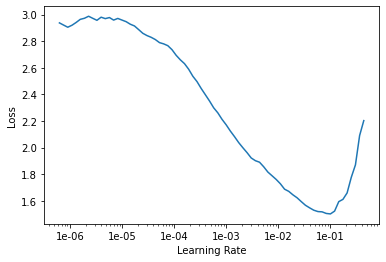

In [0]:
plot_lr()

epoch,train_loss,valid_loss,accuracy,time
0,0.486762,0.357635,0.894512,01:12
1,0.342864,0.316395,0.904847,01:10
2,0.399434,0.351574,0.892730,01:11
3,0.401473,0.445984,0.855666,01:09
4,0.340588,0.437882,0.855310,01:10
5,0.348806,0.418193,0.869922,01:10
6,0.318997,0.245672,0.914469,01:10
7,0.297997,0.225548,0.925517,01:09
8,0.236378,0.261079,0.909480,01:10
9,0.224924,0.197160,0.936208,01:10


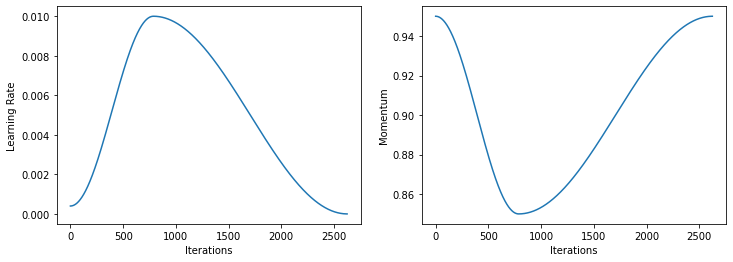

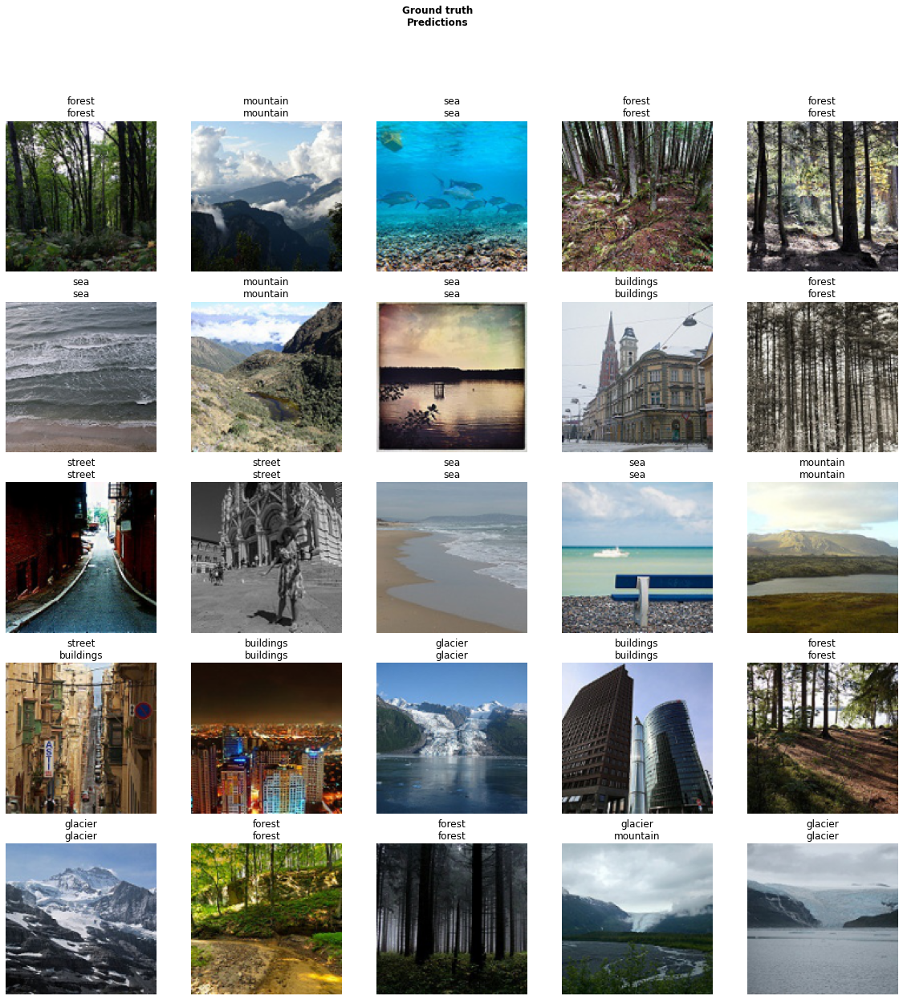

In [0]:
train(path/'stage-1', 1e-2, cbs = None, epochs = 15)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 2.75E-06
Min loss divided by 10: 5.75E-07


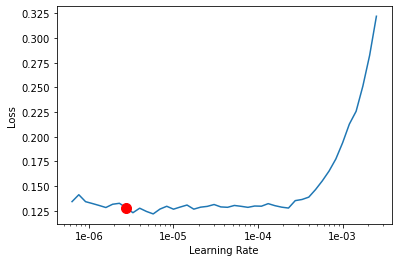

In [0]:
learn.unfreeze()
plot_lr()

epoch,train_loss,valid_loss,accuracy,time
0,0.113992,0.175920,0.941910,01:30
1,0.120237,0.175845,0.944761,01:30
2,0.126680,0.178334,0.941197,01:30
3,0.119410,0.182005,0.941197,01:30
4,0.110013,0.180987,0.940485,01:30
5,0.098000,0.183343,0.942623,01:30
6,0.099195,0.187647,0.942979,01:30
7,0.096741,0.185793,0.944048,01:30
8,0.093789,0.185492,0.940128,01:30
9,0.086340,0.183887,0.942623,01:30


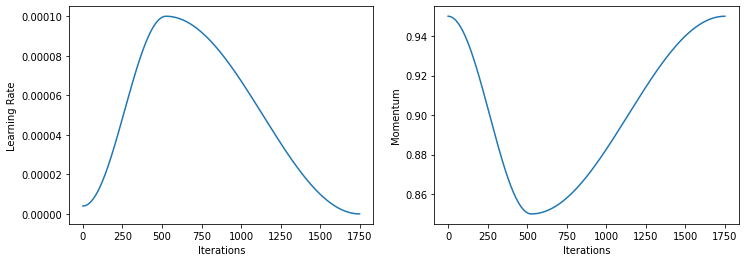

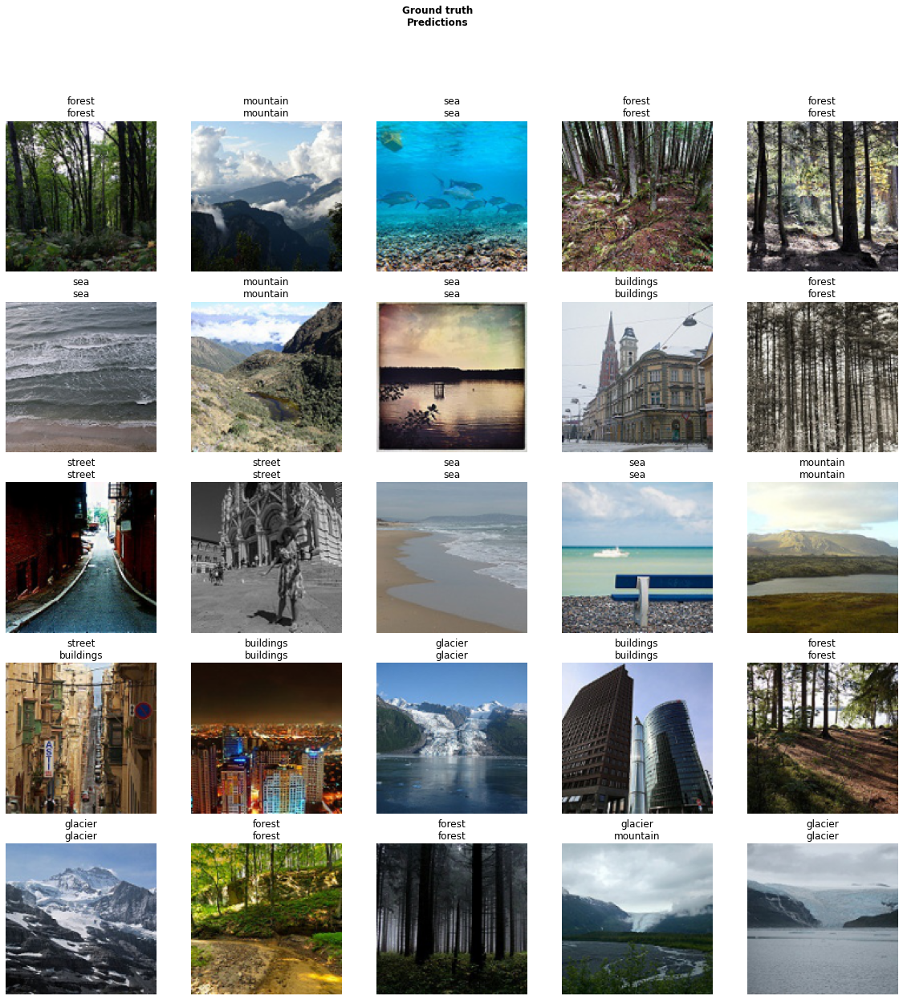

In [0]:
train(path/'stage-1-unfreeze', slice(1e-6, 1e-4), cbs = None)

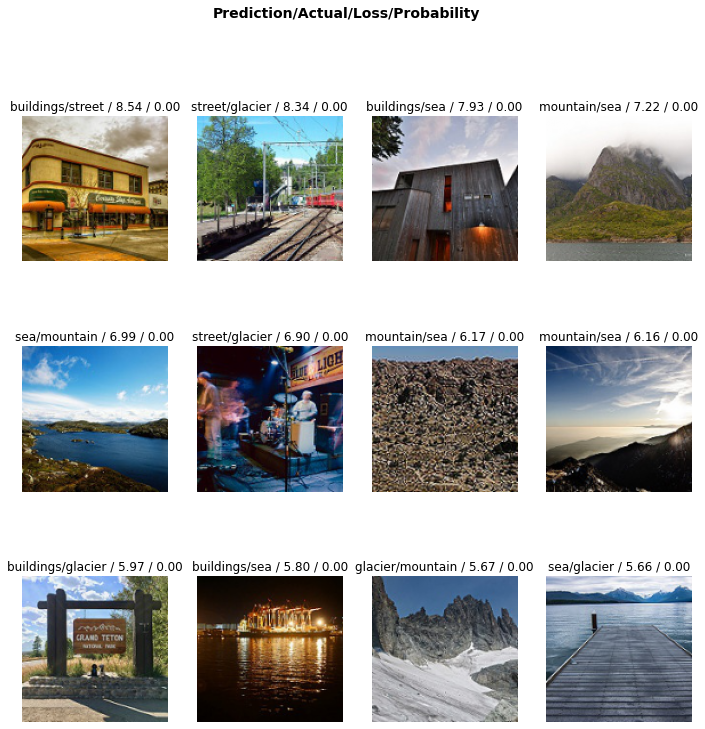

In [0]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_top_losses(12)

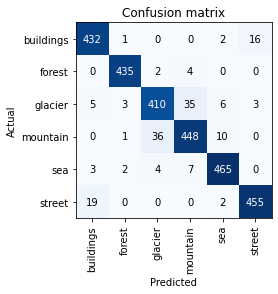

In [0]:
interp.plot_confusion_matrix()

In [0]:
#This function is taken from Fastai's GradCAM and modified to plot the heapmaps on a given axes 
def GradCAM(ax, idx, intep, ds_type = DatasetType.Valid, classes = target_classes , 
            heatmap_thresh = 16, image = True) : 
    m = intep.learn.model.eval()
    im,cl = intep.learn.data.dl(ds_type).dataset[idx]
    cl = int(cl)
    xb,_ = intep.data.one_item(im, detach=False, denorm=False) #put into a minibatch of batch size = 1
    with hook_output(m[0]) as hook_a: 
        with hook_output(m[0], grad=True) as hook_g:
            preds = m(xb)
            preds[0,int(cl)].backward() 
            acts  = hook_a.stored[0].cpu() #activation maps
            if (acts.shape[-1]*acts.shape[-2]) >= heatmap_thresh:
                grad = hook_g.stored[0][0].cpu()
                grad_chan = grad.mean(1).mean(1)
                mult = F.relu(((acts*grad_chan[...,None,None])).sum(0))
                if image:
                    xb_im = Image(xb[0])
                    sz = list(xb_im.shape[-2:])
                    xb_im.show(ax,title=f"pred. class: {classes[interp.pred_class[idx]]}, \nactual class: {interp.learn.data.classes[cl]}")
                    ax.imshow(mult, alpha=0.5, extent=(0,*sz[::-1],0),
                              interpolation='bilinear', cmap='magma')
    return mult

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

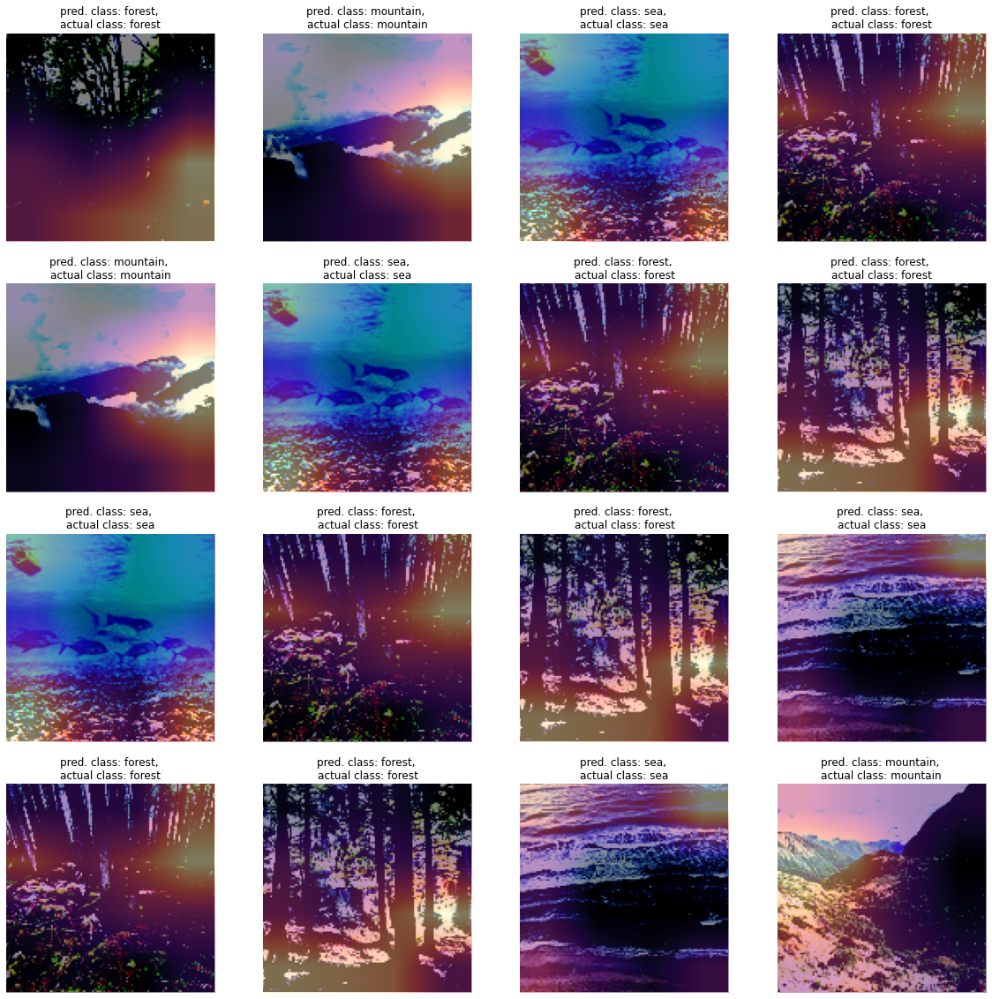

In [0]:
#Showing the active regions detected by the model through heapmap
m, n = 4, 4
fig, ax = plt.subplots(m, n, figsize = (20,20))
for i in range(m) : 
    for j in range(n) : 
        GradCAM(ax[i][j], i + j , interp, classes = target_classes, heatmap_thresh=16)

In [0]:
train_data, train_src = getDataFromFolder(train_path, bs = 32, size = 224, seed = 1997)
test_data, test_src = getDataFromFolder(train_path, bs = 32, size = 224, seed = 1997, split = False)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 7.59E-07
Min loss divided by 10: 1.00E-06


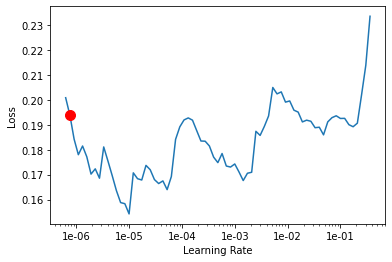

In [0]:
learn.data = train_data
learn.freeze()
plot_lr()

epoch,train_loss,valid_loss,accuracy,time
0,0.196937,0.200487,0.932644,03:13
1,0.195995,0.198205,0.932288,03:10
2,0.172097,0.196277,0.934070,03:12
3,0.181182,0.195722,0.933001,03:13
4,0.179758,0.200701,0.932644,03:13
5,0.179791,0.193689,0.934426,03:11
6,0.165360,0.191859,0.933713,03:13
7,0.157000,0.192464,0.933357,03:13
8,0.173625,0.193235,0.934783,03:14
9,0.165683,0.199827,0.931219,03:11


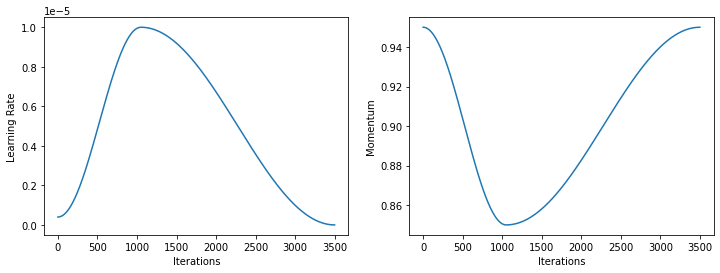

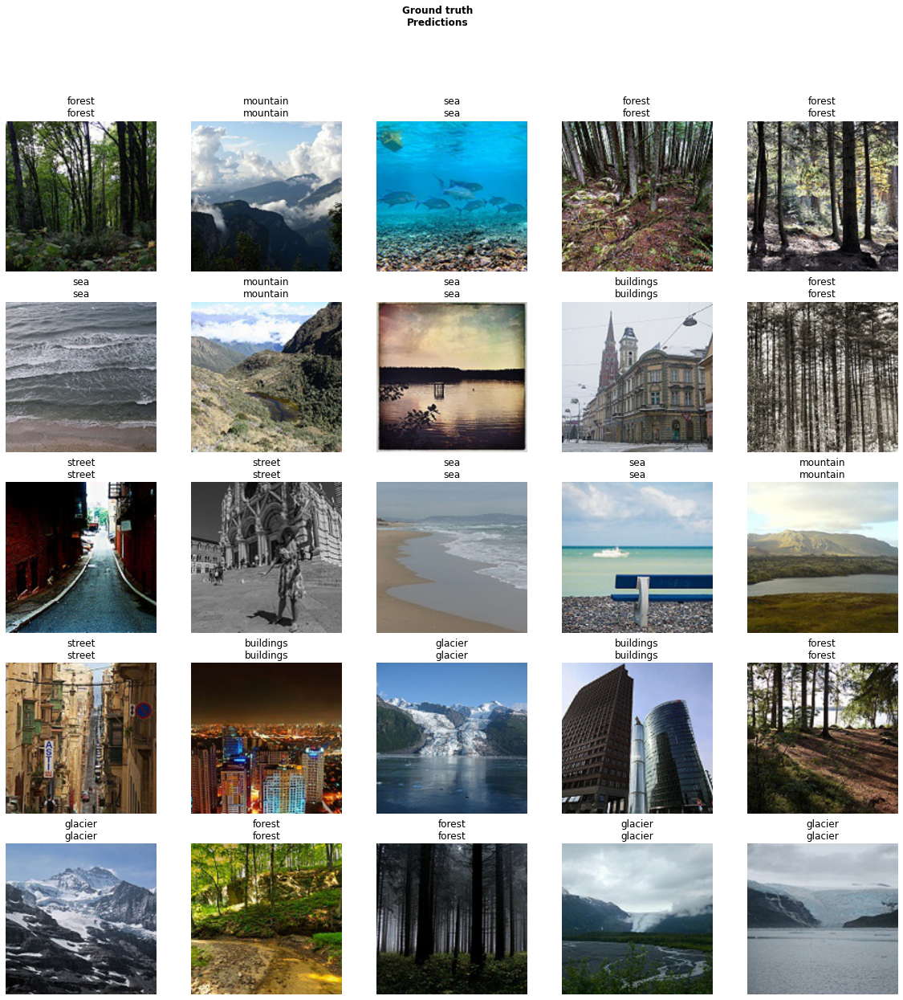

In [0]:
train(path/'stage-2', 1e-5, cbs = None)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 6.31E-07
Min loss divided by 10: 1.10E-05


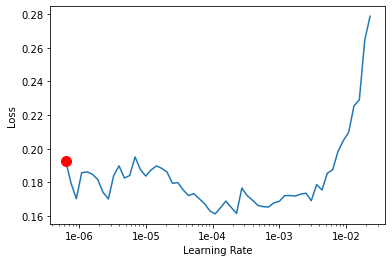

In [0]:
learn.unfreeze()
plot_lr()

epoch,train_loss,valid_loss,accuracy,time
0,0.189409,0.186360,0.937634,04:17
1,0.179624,0.181384,0.936208,04:17
2,0.174580,0.176844,0.939059,04:16
3,0.154885,0.170307,0.943692,04:17
4,0.148889,0.166449,0.945118,04:17
5,0.131742,0.170436,0.946899,04:17
6,0.136183,0.170334,0.945830,04:17
7,0.113123,0.171482,0.945474,04:17
8,0.112702,0.172291,0.946543,04:17
9,0.103081,0.171683,0.945118,04:17


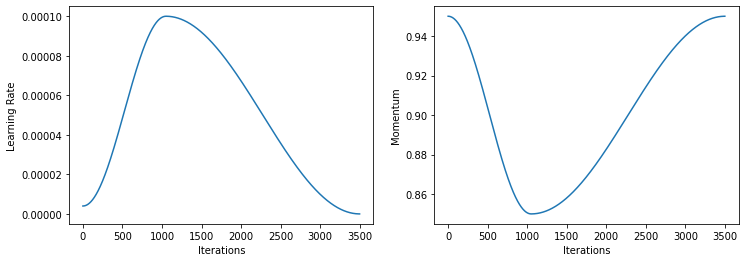

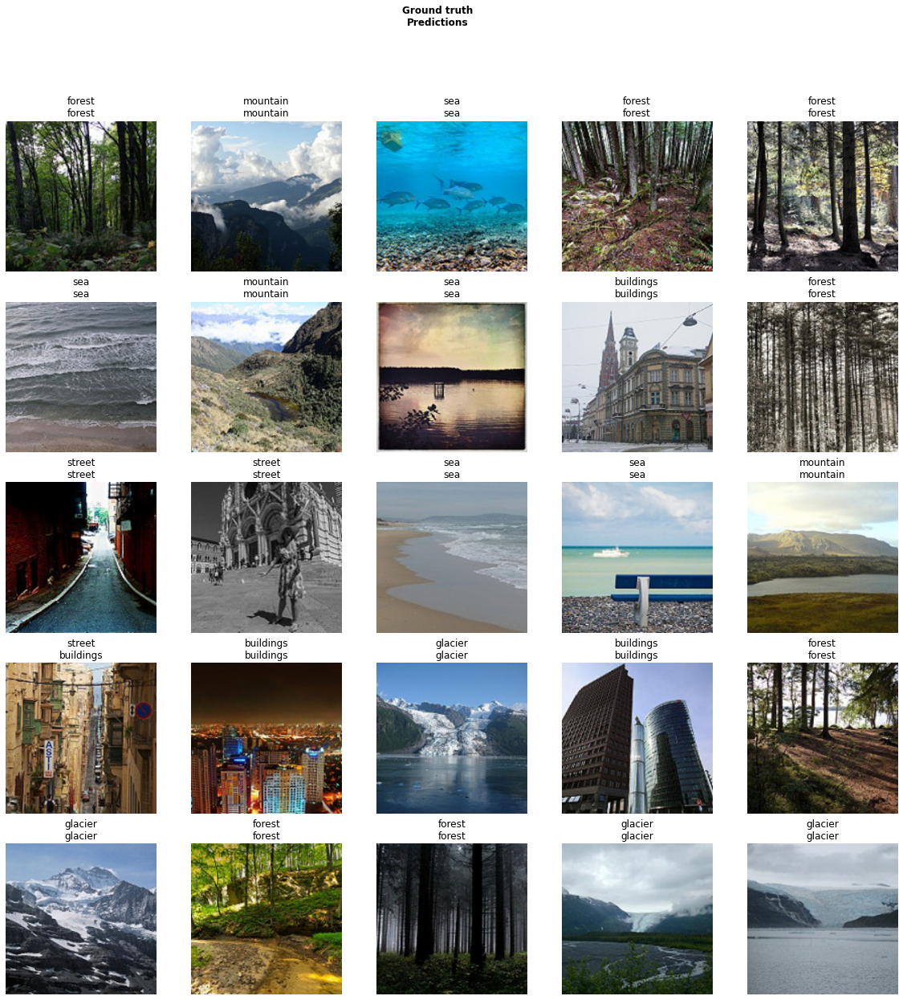

In [0]:
train(path/'stage-2-unfreeze', slice(1e-6, 1e-4), cbs = None)

In [0]:
interp = ClassificationInterpretation.from_learner(learn)

2779 misclassified samples over 2806 samples in the validation set.


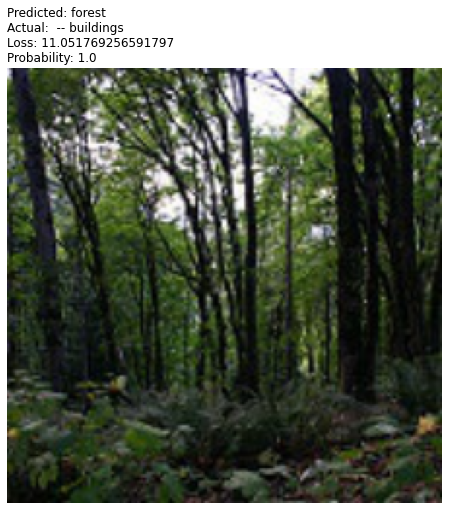

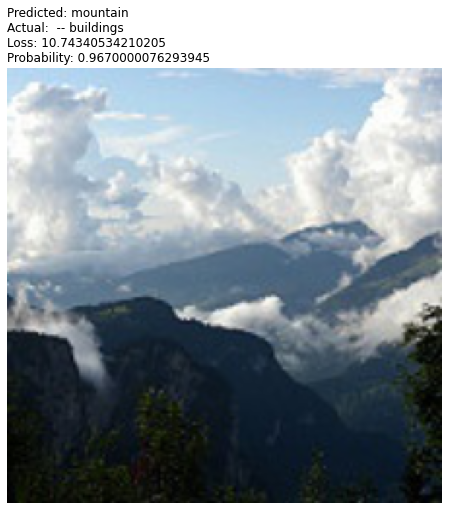

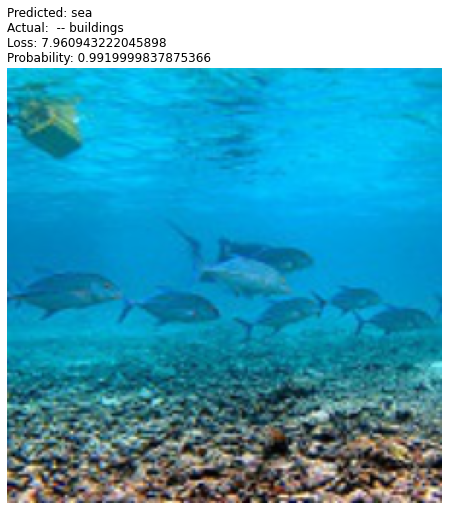

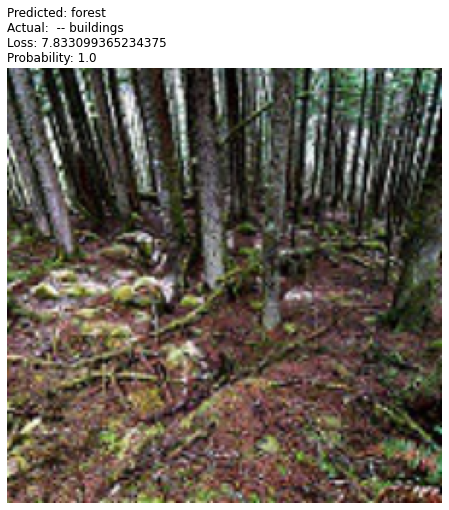

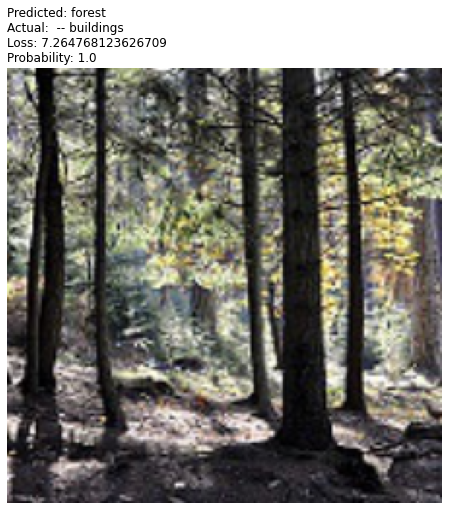

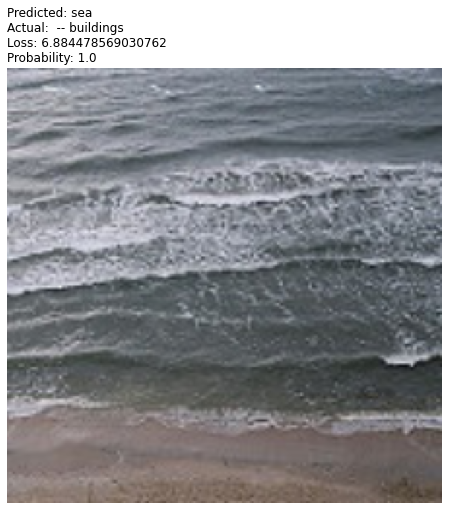

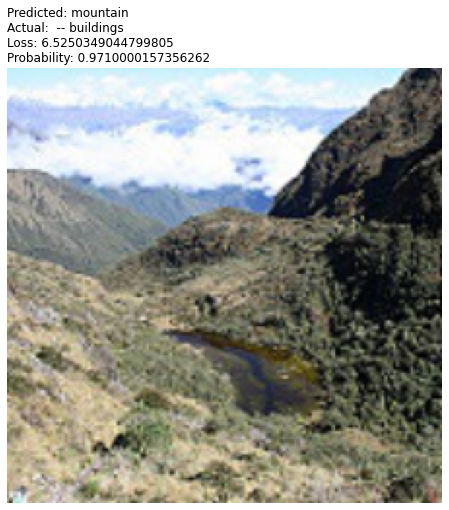

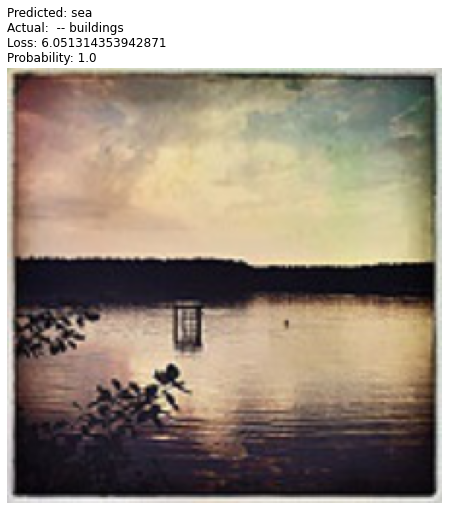

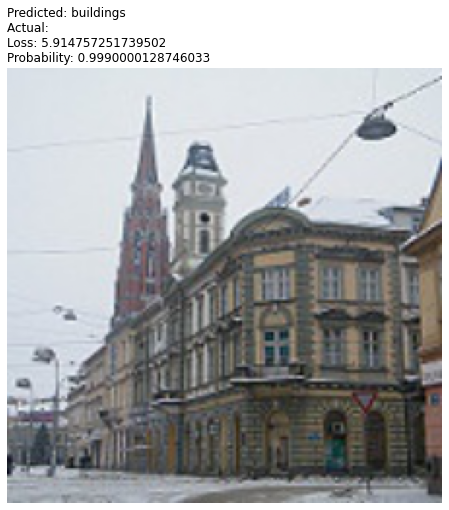

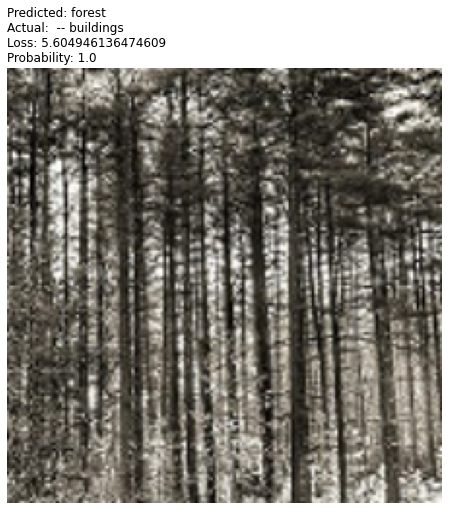

In [0]:
interp.plot_multi_top_losses(10)

In [0]:
learn.export(path/'Intel image Classifier.pkl', destroy = True)

this Learner object self-destroyed - it still exists, but no longer usable


In [0]:
learn = load_learner(path, 'Intel image Classifier.pkl')

In [0]:
learn.data = test_data
learn.model.eval();

In [13]:
learn.data

ImageDataBunch;

Train: LabelList (14034 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
street,street,street,street,street
Path: /content/seg_train/seg_train;

Valid: LabelList (0 items)
x: ImageList

y: CategoryList

Path: /content/seg_train/seg_train;

Test: None

In [15]:
test_preds, test_y = learn.get_preds(ds_type = DatasetType.Train)
test_preds = test_preds.argmax(-1)

In [23]:
print("Accuracy :", accuracy_score(test_y, test_preds))
print("F1 Score :", f1_score(test_y, test_preds, average = 'micro'))
print("Confusion Matrix :", confusion_matrix(test_y, test_preds), sep = '\n')
print("Classification Report :", classification_report(test_y, test_preds), sep = '\n')

Accuracy : 0.970105593607306
F1 Score : 0.970105593607306
Confusion Matrix :
[[2114    1    0    2    3   66]
 [   1 2255    2    7    1    1]
 [   9    4 2266  107   14    3]
 [   0    1  106 2396    7    0]
 [   3    1   14    5 2245    2]
 [  52    1    2    0    4 2321]]
Classification Report :
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      2186
           1       1.00      0.99      1.00      2267
           2       0.95      0.94      0.95      2403
           3       0.95      0.95      0.95      2510
           4       0.99      0.99      0.99      2270
           5       0.97      0.98      0.97      2380

    accuracy                           0.97     14016
   macro avg       0.97      0.97      0.97     14016
weighted avg       0.97      0.97      0.97     14016

